<a href="https://colab.research.google.com/github/ywwwei/Caltech-Honeybee/blob/main/examples/code/annotation_visualization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Caltech Honeybee Dataset Visualization

## Pollen-bearing bee detection with bounding box

In [67]:
# Set up
from IPython.display import display
import json
import os

from PIL import Image,ImageDraw, ImageFont

!git clone https://github.com/ywwwei/Caltech-Honeybee.git
%cd Caltech-Honeybee

Cloning into 'Caltech-Honeybee'...
remote: Enumerating objects: 1011, done.
remote: Counting objects: 100% (1011/1011), done.
remote: Compressing objects: 100% (1011/1011), done.
remote: Total 3989 (delta 0), reused 1010 (delta 0), pack-reused 2978
Receiving objects: 100% (3989/3989), 619.98 MiB | 36.71 MiB/s, done.
Resolving deltas: 100% (1958/1958), done.
Checking out files: 100% (3923/3923), done.
/content/Caltech-Honeybee/dataset/Caltech-Honeybee/Caltech-Honeybee/Caltech-Honeybee/Caltech-Honeybee


In [68]:
# Some helper functions
def get_circle_bbox(center, r=10):
    # return [x0, y0, x1, y1]
    x, y = center
    return [x - r, y - r, x + r, y + r]

In [69]:
def visualize_box(im_path, annotations):
  im = Image.open(im_path)
  draw = ImageDraw.Draw(im)
  font = ImageFont.truetype("./examples/code/calibrib.ttf", 15)

  colors = ['black','blue','orange']
  texts = ['bkgrd','ordinary bee','pollen bee']
  for anno in annotations:
      label = anno['class_id'] + 1
      box_location = anno['bbox']
      draw.rectangle(xy=box_location, outline=colors[label],width=5) #[x0, y0, x1, y1]

      # Text
      text_size = font.getsize(texts[label].upper())
      text_location = [box_location[0] + 2., box_location[1] - text_size[1]]
      textbox_location = [box_location[0], box_location[1] - text_size[1], box_location[0] + text_size[0] + 4.,
                          box_location[1]]
      draw.rectangle(xy=textbox_location, fill=colors[label])
      draw.text(xy=text_location, text=texts[label].upper(), fill='white',
                font=font)

  del draw

  return im

In [81]:
def visualize_line(im_path, annotations, color = 'yellow'):
    im = Image.open(im_path)
    draw = ImageDraw.Draw(im)
    im_draw = ImageDraw.Draw(im)

    for data in annotations:
        line = data['line']
        im_draw.line(line, fill=color, width=5)
        im_draw.ellipse(get_circle_bbox(line[:2], r=10), fill=color, width=1)

    del draw
    return im

In [93]:
def visualize_raw_response(im_path, annotations):
  im = Image.open(im_path)
  draw = ImageDraw.Draw(im)
  im_draw = ImageDraw.Draw(im)

  colors = ['green','red','blue']

  for i,worker_res in enumerate(annotations):
    lines = worker_res['lines']
    for line in lines:
      im_draw.line(line, fill=colors[i], width=5)
      im_draw.ellipse(get_circle_bbox(line[:2], r=10), fill=colors[i], width=1)

  del draw
  return im

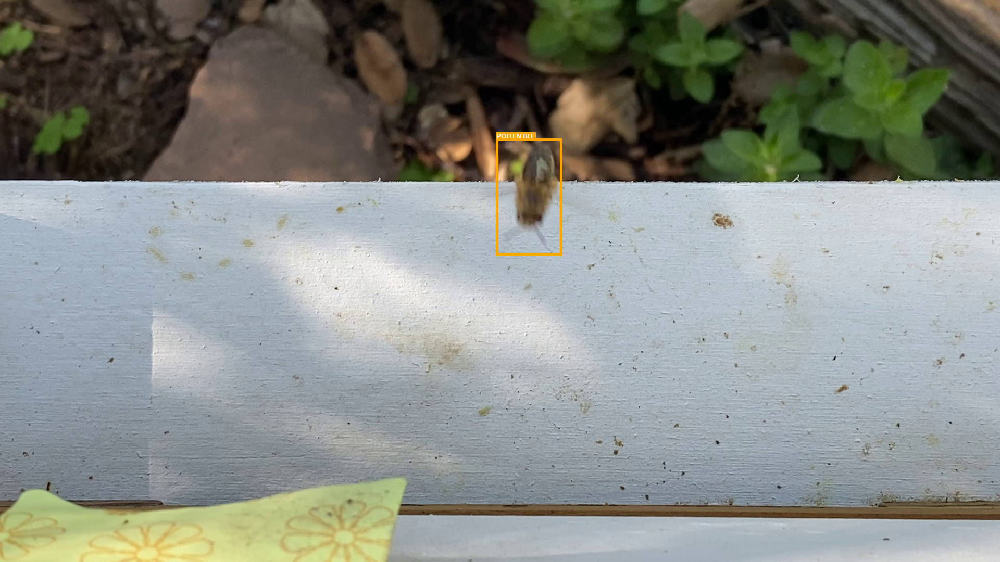

In [72]:
# Pollen_selection
# Read the first image and its annotations
im_dir = os.path.join('./dataset/pollen_classification','pollen_selection','images')
im_paths = os.listdir(im_dir)
im_paths = [f for f in im_paths if '.jpg' in f]
im_filename = im_paths[0]
im_path = os.path.join(im_dir,im_filename)

json_path = os.path.join('./dataset/pollen_classification/pollen_selection','labels',im_filename[:-4] + '.json')
with open(json_path,'r') as f:
      json_data = json.load(f)
annotations = json_data['annotations']

im = visualize_box(im_path, annotations)
display(im)

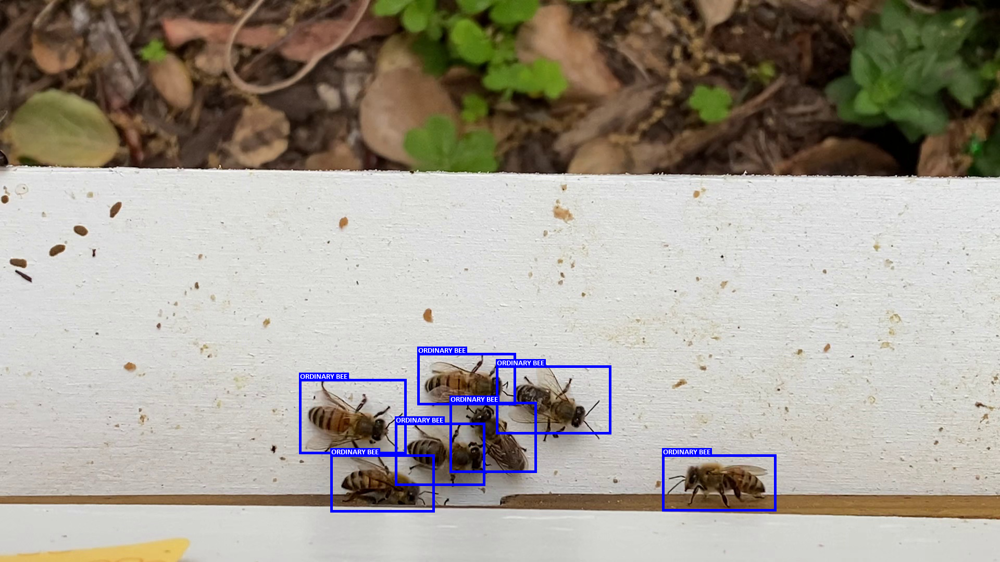

In [73]:
# Random_selection
# Read the first image and its annotations
im_dir = os.path.join('./dataset/pollen_classification','random_selection','images')
im_paths = os.listdir(im_dir)
im_paths = [f for f in im_paths if '.jpg' in f]
im_filename = im_paths[0]
im_path = os.path.join(im_dir,im_filename)

json_path = os.path.join('./dataset/pollen_classification/random_selection','labels',im_filename[:-4] + '.json')
with open(json_path,'r') as f:
      json_data = json.load(f)
annotations = json_data['annotations']

im = visualize_box(im_path, annotations)
display(im)

## Crowded bee detection with oriented line

### Original fullsize image

In [74]:
# Read image
im_dir = os.path.join('./dataset/crowd_detection','original','images')
im_filename = 'IMG_6362.jpg'
im_path = os.path.join(im_dir,im_filename)

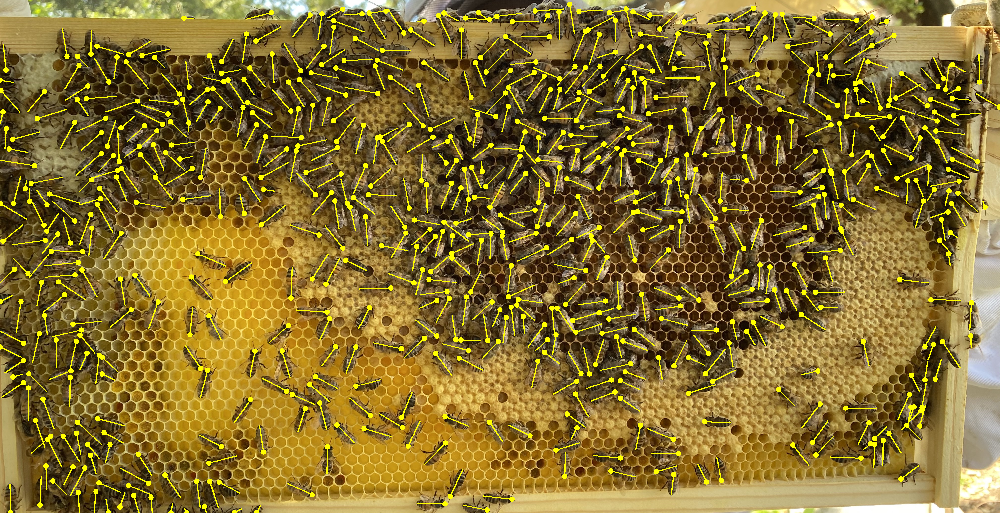

In [83]:
# Expert consolidated result
json_path = os.path.join('./dataset/crowd_detection','original','expert_labels',im_filename[:-4] + '.json')
with open(json_path,'r') as f:
      json_data = json.load(f)

annotations = json_data['consolidated annotations']
im = visualize_line(im_path, annotations)
display(im)

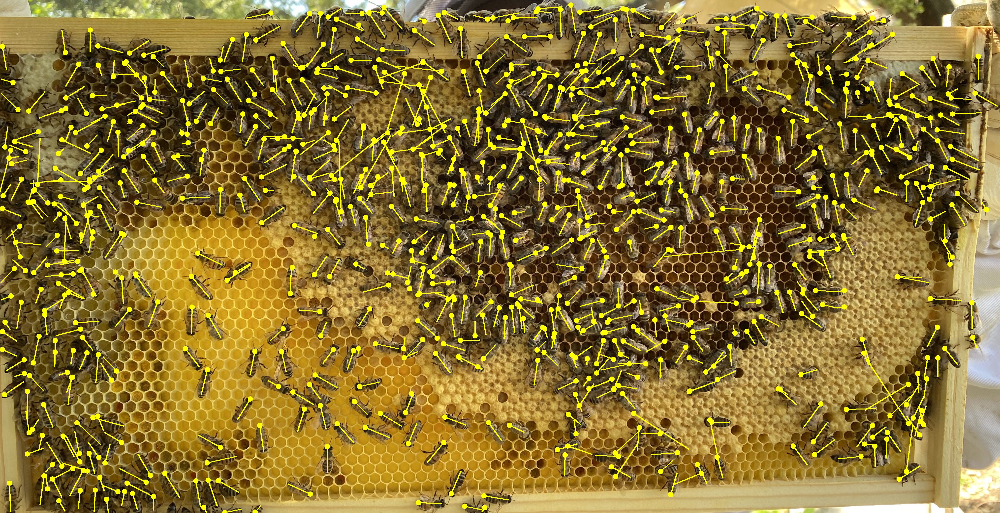

In [84]:
# Crowdsourcing consolidated result
json_path = os.path.join('./dataset/crowd_detection','original','labels',im_filename[:-4] + '.json')
with open(json_path,'r') as f:
      json_data = json.load(f)

annotations = json_data['consolidated annotations']
im = visualize_line(im_path, annotations)
display(im)

## Cropped image

In [88]:
# Read image
im_dir = os.path.join('./dataset/crowd_detection','cropped','images')
im_paths = os.listdir(im_dir)
im_paths = [f for f in im_paths if '.jpg' in f]
im_filename = im_paths[0]
im_path = os.path.join(im_dir,im_filename)

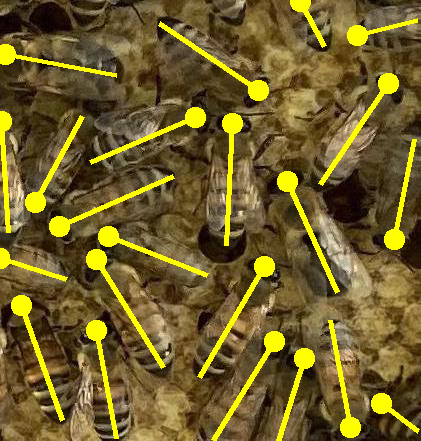

In [89]:
# Crowdsourcing consolidated annotations
json_path = os.path.join('./dataset/crowd_detection','cropped','labels',im_filename[:-4] + '.json')
#https://github.com/ywwwei/Caltech-Honeybee/blob/main/dataset/crowd_detection/original/expert_labels/IMG_6362.json
#https://github.com/ywwwei/Caltech-Honeybee/blob/main/dataset/crowd_detection/original/labels/IMG_6362.json
with open(json_path,'r') as f:
  json_data = json.load(f)

annotations = json_data['consolidated annotations']
im = visualize_line(im_path, annotations)
display(im)

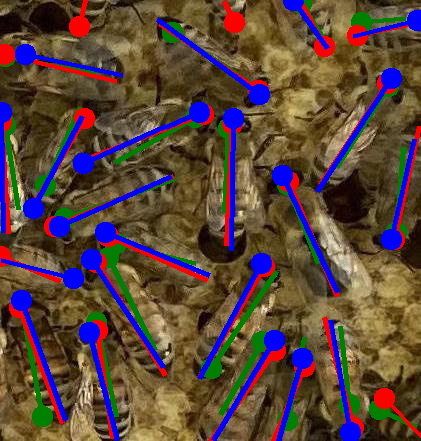

In [94]:
# Crowdsourcing raw annotations
json_path = os.path.join('./dataset/crowd_detection','cropped','labels',im_filename[:-4] + '.json')
with open(json_path,'r') as f:
      json_data = json.load(f)

annotations = json_data['raw annotations']
im = visualize_raw_response(im_path, annotations)
display(im)